[View in Colaboratory](https://colab.research.google.com/github/gauravsingh1012/AI-Adventures-Stock-Analysis-using-Tensorflow-and-Facebook-Prophet/blob/master/Pandas_For_Finance_Chapter_3_Time_series_Stock_Data_Part_III.ipynb)

In [0]:
!pip install quandl
!pip install kaggle
!pip install plotly==2.5.0

In [0]:
from googleapiclient.discovery import build
import io, os
from googleapiclient.http import MediaIoBaseDownload
from google.colab import auth

auth.authenticate_user()

drive_service = build('drive', 'v3')
results = drive_service.files().list(
        q="name = 'kaggle.json'", fields="files(id)").execute()
kaggle_api_key = results.get('files', [])

filename = "/root/.kaggle/kaggle.json"
os.makedirs(os.path.dirname(filename), exist_ok=True)

request = drive_service.files().get_media(fileId=kaggle_api_key[0]['id'])
fh = io.FileIO(filename, 'wb')
downloader = MediaIoBaseDownload(fh, request)
done = False
while done is False:
    status, done = downloader.next_chunk()
    print("Download %d%%." % int(status.progress() * 100))
os.chmod(filename, 600)

In [0]:
!kaggle datasets download jes2ica/sp-500 -f sp500.csv -p ./
import quandl
import pandas as pd
import numpy as np
import datetime

In [0]:
quandl.ApiConfig.api_key = input('Please enter your quandl Key: ')
exchange = 'WIKI'

In [0]:
def get(tickers, start, end):
   def data(ticker):
       return quandl.get('%s/%s' % (exchange, ticker),start_date = start,end_date = end)
   datas = map(data, tickers)
   return pd.concat(datas, keys=tickers, names=['Ticker','Date'])

In [0]:
start = datetime.date(2014, 1, 1)
end = datetime.date(2017, 12, 31)

tickers = ['AAPL','MSFT','GE','IBM','AA','DAL','UAL', 'PEP', 'KO']
all_data = get(tickers, start, end)
all_data[:5]

sp_500 = pd.read_csv("./sp500.csv")

sp_500.set_index(pd.DatetimeIndex(sp_500['Date']), inplace = True)

sp_500 = sp_500.loc[start:end]
msftV = all_data.loc['MSFT','Volume']
just_closing_prices = all_data[['Adj. Close']].reset_index()
daily_close_px = just_closing_prices.pivot('Date', 'Ticker','Adj. Close')
daily_pct_change = daily_close_px.pct_change()
daily_pct_change.fillna(0, inplace=True)
cum_daily_return = (1 + daily_pct_change).cumprod()

In [0]:
import random
import plotly
import IPython
import numpy as np
def configure_plotly_browser_state():
  display(IPython.core.display.HTML('''
        <script src="/static/components/requirejs/require.js"></script>
        <script>
          requirejs.config({
            paths: {
              base: '/static/base',
              plotly: 'https://cdn.plot.ly/plotly-1.5.1.min.js?noext',
            },
          });
        </script>
        '''))


def plot_df(df,name='Plot',x_title="x",y_title='y', mode='line', barmode = 'stack'):
  traces = []

  call_count = 0
  configure_plotly_browser_state()
  r = lambda: random.randint(0,255)
  plotly.offline.init_notebook_mode(connected=False)
  for column in df:
    if mode == 'line':
      trace = plotly.graph_objs.Scattergl( 
        x=df.index, 
        y=df[column],
        mode=mode,
        name=column, 
        line=dict(
            color = 'rgb(r(),r(),r())'
        )
      )
      traces.append(trace)
    elif mode == 'Bar' and column != 'Date':
      trace = plotly.graph_objs.Bar( 
        x=df['Date'],
        y=df[column],
        )
      traces.append(trace)
    elif mode == 'Candle' and call_count == 0:
      trace = plotly.graph_objs.Candlestick(
         x=df.index,
         open=df.Open,
         high=df.High,
         low=df.Low,
         close=df.Close)
      traces.append(trace)
      call_count += 1
    elif mode == 'Histogram' and isinstance(df, pd.Series) and call_count == 0:
      trace = plotly.graph_objs.Histogram(
         x=df.values
         )
      traces.append(trace)
      call_count += 1
    elif mode == 'Histogram' and isinstance(df,pd.DataFrame):
      trace = plotly.graph_objs.Histogram(
         x=df[column],
         name=column
         )
      traces.append(trace)
    elif mode == 'Box':
      trace = plotly.graph_objs.Box(
         y=df[column],
         name=column
         )
      traces.append(trace) 
    elif mode == 'Scatter' and call_count == 0:
      trace = plotly.graph_objs.Scattergl(
         x=df[x_title].values,
         y=df[y_title].values,
         mode='markers'
         )
      traces.append(trace)
      call_count += 1
     
    layout = plotly.graph_objs.Layout(
      title=name,
      yaxis=dict(title=y_title),
      xaxis=dict(title=x_title),
      barmode=barmode
    )
  
  plotly.offline.iplot({'data':traces,'layout':layout})



>>**V.    Moving windows**: A number of functions are provided to compute moving (also known as rolling)
statistics, where the function computes the statistic on a window of data represented
by a particular period of time and then slides the window across the data by a
specified interval, continually calculating the statistic as long as the window falls first
within the dates of the time-series.

>>With the following functions, pandas provides direct support for rolling windows:

>>>Function :  Description

>>>rolling_mean : This is the mean of the values in the window

>>>rolling_std : This is the standard deviation of the values in the window

>>>rolling_var :This is the variance of values

>>>rolling_min : This is the minimum of the values in the window

>>>rolling_max : This is maximum of the values in the window

>>>rolling_cov : This is the covariance of values

>>>rolling_quantile : This is the moving window score at the percentile/sample quantile

>>>rolling_corr : This is the correlation of the values in the window

>>>rolling_median : This is the median of the values in the window

>>>rolling_sum : This is the sum of the values in the window

>>>rolling_apply : This is the application of a user function to the values in the window

>>>rolling_count : This is the number of non-NaN values in a window

>>>rolling_skew : This is the skewedness of the values in the window

>>>rolling_kurt : This is the kurtosis of the values in the window.


>>As a practical example, a rolling mean is commonly used to smooth out short-term
fluctuations and highlight longer-term trends in data and is used quite commonly in
financial time-series analysis.

>> To demonstrate this, we will calculate a rolling window on the adjusted close values
for MSFT for the year 2014. The following command extracts the raw values for 2012
and plots them to gives us an idea of the shape of the data:

In [0]:
msft = all_data.loc['MSFT'].loc['2014-01':'2014-12']

msftAC = msft[['Adj. Close']]
msftAC[:5]

,Adj. Close
Date,
2014-01-02,33.532800
2014-01-03,33.307202
2014-01-06,32.603338
2014-01-07,32.856007
2014-01-08,32.269454


>>The following command calculates the rolling mean with a window of 5 periods and
plots it against the raw data:

In [0]:
msftAC["Rolling_Mean_5"] = pd.rolling_mean(msftAC["Adj. Close"], 5)
plot_df(msftAC,"Microsoft Adj. Close Rolling Mean", "Date", "Adj. Close")

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:1: FutureWarning:

pd.rolling_mean is deprecated for Series and will be removed in a future version, replace with 
	Series.rolling(window=5,center=False).mean()

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:1: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy



>>From this, it can be seen how the pd.rolling_mean function provides a smoother
representation of the underlying data. A larger window smoothens out the variance
but at the cost of accuracy. We can see how this gets smoother as the window size
is increased. The following command plots the rolling mean of window size 5 , 10 ,
and 20 periods against the raw data:

In [0]:
msftAC["Rolling_Mean_10"] = pd.rolling_mean(msftAC["Adj. Close"], 10)
msftAC["Rolling_Mean_15"] = pd.rolling_mean(msftAC["Adj. Close"], 15)
plot_df(msftAC,"Microsoft Adj. Close Rolling Mean", "Date", "Adj. Close")

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:1: FutureWarning:

pd.rolling_mean is deprecated for Series and will be removed in a future version, replace with 
	Series.rolling(window=10,center=False).mean()

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:1: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:2: FutureWarning:

pd.rolling_mean is deprecated for Series and will be removed in a future version, replace with 
	Series.rolling(window=15,center=False).mean()

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:2: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

S

>>Note that the larger the window, the more the data missing at the beginning of
the curve. A window of size n requires n data points before the measure can be
calculated, hence the gap in the beginning of the plot.

>>Any function can be applied via a rolling window using the pd.rolling_apply
function. The supplied function will be passed an array of values in the window
and should return a single value. Then pandas will combine these results into a
time-series.

>>To demonstrate this, the following command calculates the mean average deviation,
which gives a feel of how far on average all the values in the sample are from the
overall mean:

In [0]:
mean_abs_dev = lambda x: np.fabs(x - x.mean()).mean()
msftAC["mean_abs_dev"] = pd.rolling_apply(msftAC["Adj. Close"], 5, mean_abs_dev)
plot_df(msftAC, "mean average deviation",  "Date", "Adj. Close")

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:2: FutureWarning:

pd.rolling_apply is deprecated for Series and will be removed in a future version, replace with 
	Series.rolling(window=5,center=False).apply(func=<function>,args=<tuple>,kwargs=<dict>)

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:2: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy



>>An expanding window mean can be calculated using a slight variant of the
pd.rolling_mean function that repeatedly calculates the mean by always starting
with the first value in the time-series, and for every iteration, increasing the window
size by one. An expanding window mean will be more stable (less responsive) than
a rolling window because greater the size of the window, the less the impact of the
next value:

In [0]:
expanding_mean = lambda x: pd.rolling_mean(x, len(x), min_periods=1)
msftAC["expanding_mean"] = pd.expanding_mean(msftAC["Adj. Close"])
plot_df(msftAC, "expanding mean",  "Date", "Adj. Close")

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:2: FutureWarning:

pd.expanding_mean is deprecated for Series and will be removed in a future version, replace with 
	Series.expanding(min_periods=1).mean()

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:2: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy



>>**VI.    Volatility calculation**:   The volatility of a stock is a measurement of the change in variance in the returns
of a stock over a specific period of time. It is common to compare the volatility of
a stock with another stock to get a feel for which may have less risk or to a market
index to examine the stock's volatility in the overall market. Generally, the higher the
volatility, the riskier the investment in that stock, which results in investing in one
over another.

>>Volatility is calculated by taking a rolling window standard deviation on the
percentage change in a stock. The size of the window affects the overall result. The
wider the window, the less representative the measurement will become. As the
window narrows, the result approaches the standard deviation. So, it is a bit of
an art to pick the proper window size based upon the data sampling frequency.
Fortunately, pandas makes this very easy to modify interactively.

>>As a demonstration, the following command calculates the volatility of all the stock
in our sample with a window of 75 days:


In [0]:
min_periods = 75
vol = pd.rolling_std(daily_pct_change, min_periods) * np.sqrt(min_periods)
plot_df(vol, "Volatility calculation: by taking a rolling window (75) standard deviation on the percentage change in a stock", "Date", "Change in Variance in Returns")

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:2: FutureWarning:

pd.rolling_std is deprecated for DataFrame and will be removed in a future version, replace with 
	DataFrame.rolling(window=75,center=False).std()



>>The lines higher on the chart represent overall higher volatility and hence represent
a riskier investment. PEP seems to have the lowest overall volatility, while it appears
that UAL has the highest

>>**VII.   Rolling correlation of returns**:    We previously examined the calculation of the overall correlation between two
stocks over a time period (3 years in our case). This can also be performed using
rolling windows to demonstrate how the correlation has changed over time:

In [0]:


Rolling_corr = daily_pct_change[['AAPL']]
Rolling_corr["MSFT"] = daily_pct_change['MSFT']
Rolling_corr["Rolling_Corr"] = pd.rolling_corr(Rolling_corr['AAPL'],Rolling_corr['MSFT'],window=252).dropna()
plot_df(Rolling_corr, "Rolling correlation of returns: This can also be performed using rolling windows to demonstrate how the correlation has changed over time", "Date", "Change in Correlations of Returns")

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:4: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:5: FutureWarning:

pd.rolling_corr is deprecated for Series and will be removed in a future version, replace with 
	Series.rolling(window=252).corr(other=<Series>)

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:5: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy



>>**VIII.    Comparing stocks to the S&P 500**:   The analyses until this point have been performed only between stocks. It is often
useful to perform some of these against a market index such as the S&P 500. This
will give a sense of how those stocks compare to movements in the overall market.

>>At the beginning of the chapter, we loaded the S&P 500 data for the same time period
as the other stocks. To perform comparisons, we can perform the same calculations
to derive the daily percentage change and cumulative returns on the index:

In [0]:
sp_500_dpc = sp_500['Adj Close'].pct_change().fillna(0)
sp_500_dpc[:5]

Date
2014-01-02    0.000000
2014-01-03   -0.000333
2014-01-06   -0.002512
2014-01-07    0.006082
2014-01-08   -0.000212
Name: Adj Close, dtype: float64

>>We can concatenate the index calculations in the results of the calculations of the
stocks. This will let us easily compare the overall set of stocks and index calculations:

In [0]:
dpc_all = pd.concat([sp_500_dpc, daily_pct_change], axis=1)
dpc_all.rename(columns={'Adj Close': 'SP500'}, inplace=True)
dpc_all[:5]

,SP500,AA,AAPL,DAL,GE,IBM,KO,MSFT,PEP,UAL
Date,,,,,,,,,,
2014-01-02,0.000000,0.0,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
2014-01-03,-0.000333,0.0,-0.021966,0.055235,-0.000727,0.005983,-0.004919,-0.006728,0.001705,0.058839
2014-01-06,-0.002512,0.0,0.005453,0.002053,-0.008006,-0.003429,-0.004696,-0.021132,0.000486,-0.014768
2014-01-07,0.006082,0.0,-0.007156,-0.017412,0.001101,0.019946,0.002980,0.007750,0.014584,-0.017022
2014-01-08,-0.000212,0.0,0.006338,0.035441,-0.002931,-0.009172,-0.011141,-0.017852,-0.002875,0.060222


>>Now, we calculate the cumulative daily returns with the following command:

In [0]:
cdr_all = (1 + dpc_all).cumprod()
cdr_all[:5]

,SP500,AA,AAPL,DAL,GE,IBM,KO,MSFT,PEP,UAL
Date,,,,,,,,,,
2014-01-02,1.000000,1.0,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000
2014-01-03,0.999667,1.0,0.978034,1.055235,0.999273,1.005983,0.995081,0.993272,1.001705,1.058839
2014-01-06,0.997156,1.0,0.983367,1.057401,0.991273,1.002533,0.990408,0.972282,1.002192,1.043202
2014-01-07,1.003221,1.0,0.976330,1.038989,0.992364,1.022530,0.993360,0.979817,1.016809,1.025444
2014-01-08,1.003008,1.0,0.982518,1.075812,0.989455,1.013152,0.982292,0.962325,1.013886,1.087199


In [0]:
dpc_corrs = dpc_all.corr()
dpc_corrs.loc[:,'SP500']

SP500    1.000000
AA       0.111651
AAPL     0.563346
DAL      0.543778
GE       0.631079
IBM      0.584660
KO       0.491881
MSFT     0.658491
PEP      0.571030
UAL      0.435687
Name: SP500, dtype: float64

>>GE, MSFT shows that it moved in the most similar way to the S&P 500. A plot of the returns shows this, as GE , MSFT indeed
follows right along the S&P 500, which was quite a good investment relative to the
S&P 500

In [0]:
cdr_plot_df = cdr_all[['SP500', 'GE', 'MSFT']]
plot_df(cdr_plot_df, "GE, MSFT shows that it moved in the most similar way to the S&P 500", "Date", "cumulative daily returns ")

In [0]:
cdr_plot_df = cdr_all[[ 'UAL', 'SP500']]
plot_df(cdr_plot_df, "UAL vs SP500", "Date", "Cumulative Daily Returns")

>>We can examine these conclusions with scatter plots of both against the S&P 500, as
shown here:

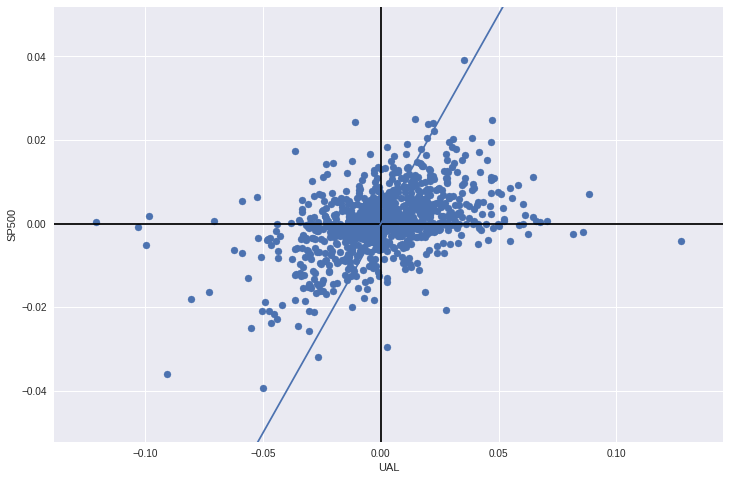

In [0]:
render_scatter_plot(dpc_all, 'UAL', 'SP500')

>>This shows that GE is fairly tightly correlated to the S&P 500. UAL has a much more
distributed cluster of points around the origin, which supports that it has a lot less
correlation.

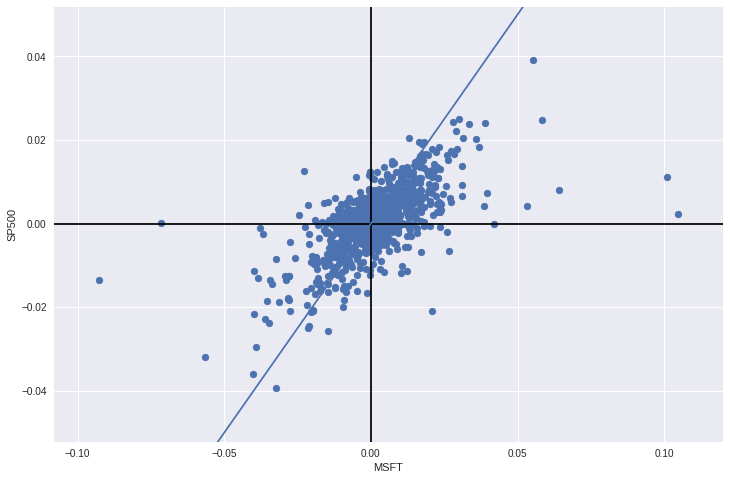

In [0]:
render_scatter_plot(dpc_all, 'MSFT', 'SP500')

**Summary 3. Analyzing the distribution of returns**:

>**iV.    Moving windows**: A number of functions are provided to compute moving (also known as rolling)
statistics, where the function computes the statistic on a window of data represented
by a particular period of time and then slides the window across the data by a
specified interval, continually calculating the statistic as long as the window falls first
within the dates of the time-series.

>With the following functions, pandas provides direct support for rolling windows:

>>**a. rolling_mean** : This is the mean of the values in the window.  This provides a smoother
representation of the underlying data. A larger window smoothens out the variance
but at the cost of accuracy


```
        window_size =5
        pd.rolling_mean(msftAC["Adj. Close"], window_size)
        expanding_mean = lambda x: pd.rolling_mean(x, len(x), min_periods=1)
        msftAC["expanding_mean"] = pd.expanding_mean(msftAC["Adj. Close"])
        plot_df(msftAC, "expanding mean",  "Date", "Adj. Close")
```



>>**b. rolling_std** : This is the standard deviation of the values in the window. This is used in volatility calculations

```
         min_periods = 75
         vol = pd.rolling_std(daily_pct_change, min_periods) * np.sqrt(min_periods)
```

>>**c. rolling_corr** : This is the correlation of the values in the window. This demonstrate how the correlation has changed over time:



```
          Rolling_corr = daily_pct_change[['AAPL']]
          Rolling_corr["MSFT"] = daily_pct_change['MSFT']
          Rolling_corr["Rolling_Corr"] = pd.rolling_corr(Rolling_corr['AAPL'],Rolling_corr['MSFT'],window=252).dropna()

```
>>**d. rolling_apply** : This is the application of a user function to the values in the window. 


```
        mean_abs_dev = lambda x: np.fabs(x - x.mean()).mean()
        pd.rolling_apply(msftAC["Adj. Close"], 5, mean_abs_dev)
```

